This notebook focuses on using Explainable AI (XAI) techniques to interpret the predictions of a deep learning model for biomedical image analysis. It implements and compares three gradient-based methods for generating heatmaps: **Grad-CAM**, **Grad-CAM++**, and **Saliency Maps**.

For the Grad-CAM and Grad-CAM++ analysis, the notebook uses the best-saved model from the multi-class classification phase, which is a **MONAI+densenet121** model. A key aspect of this notebook is that the heatmaps and saliency maps are not only visualized but also saved as a **preprocessing step** for a later XAI task, providing a crucial visual representation of the model's focus for subsequent analysis.



In [ ]:
from glob import glob
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install -q "monai-weekly[pillow, tqdm]" #Install required dependencies
!pip install -q matplotlib
%matplotlib inline

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 37.1 MB/s eta 0:00:00


In [ ]:
import os
root_dir = '/content/drive'
print(root_dir)


/content/drive


In [ ]:
import os
import shutil
import tempfile
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import cv2
from sklearn.metrics import classification_report
import torch
from monai.apps import download_and_extract
from monai.config import print_config
from monai.metrics import ROCAUCMetric
from monai.networks.nets import DenseNet121
from monai.transforms import *
from monai.data import Dataset, DataLoader, decollate_batch
from monai.utils import set_determinism

In [ ]:
train_dir  ="/content/drive/MyDrive/MACENKO/"
test_dir = "/content/drive/MyDrive/images/"

In [ ]:
#train
class_names0 = os.listdir(test_dir)
class_names = sorted(class_names0)
print(class_names)
num_class = len(class_names)

image_files = [[os.path.join(train_dir, class_name, x)
               for x in os.listdir(os.path.join(train_dir, class_name))]
               for class_name in class_names]

image_file_list = []
image_label_list = []
for i, class_name in enumerate(class_names):
    image_file_list.extend(image_files[i])
    image_label_list.extend([i] * len(image_files[i]))

num_total = len(image_label_list)


['actionmadureapelletrii', 'falciformisporasenegalensis', 'madurellamycetomatis', 'streptomycessomaliesnis']


In [ ]:
#test
t_image_files = [[os.path.join(test_dir, class_name, x)
               for x in os.listdir(os.path.join(test_dir, class_name))]
               for class_name in class_names]

t_image_file_list = []
t_image_label_list = []
for i, class_name in enumerate(class_names):
    t_image_file_list.extend(t_image_files[i])
    t_image_label_list.extend([i] * len(t_image_files[i]))

In [ ]:
testX=t_image_file_list
testY=t_image_label_list

print(len(testX))

1324


In [ ]:
test_x=np.array(testX)
test_y=np.array(testY)

In [ ]:
val_transforms = Compose([LoadImage(image_only=True, reader="PILReader", reverse_indexing=False),
        EnsureChannelFirst(),
        ScaleIntensity(),
        #Resize((300,300))
        ])

In [ ]:
class MedNISTDataset(torch.utils.data.Dataset):
    def __init__(self, image_files, labels, transforms):
        self.image_files = image_files
        self.labels = labels
        self.transforms = transforms

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, index):
        return self.transforms(self.image_files[index]), self.labels[index]


test_ds = MedNISTDataset(test_x, test_y, val_transforms)
test_loader = DataLoader(test_ds, batch_size=1)

In [ ]:
def imshow(image, ax=None, title=None, normalize=True):
    """Imshow for Tensor."""
    if ax is None:
        fig, ax = plt.subplots()
    image = image.numpy().transpose((1, 2, 0))

    if normalize:
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image = std * image + mean
        image = np.clip(image, 0, 1)

    ax.imshow(image)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.tick_params(axis='both', length=0)
    ax.set_xticklabels('')
    ax.set_yticklabels('')

    return ax


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DenseNet121(spatial_dims=2, in_channels=3, out_channels=num_class).to(device)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from monai.visualize import GradCAM
from monai.transforms import EnsureType
import random

model.load_state_dict(torch.load("/content/drive/MyDrive/Macenko-best_metric_model.pth", map_location=device))

model.eval()

DenseNet121(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (layers): Sequential(
          (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
      )
      (denselayer2): _DenseLayer(
        (layers): Sequential(
          (norm1): BatchN

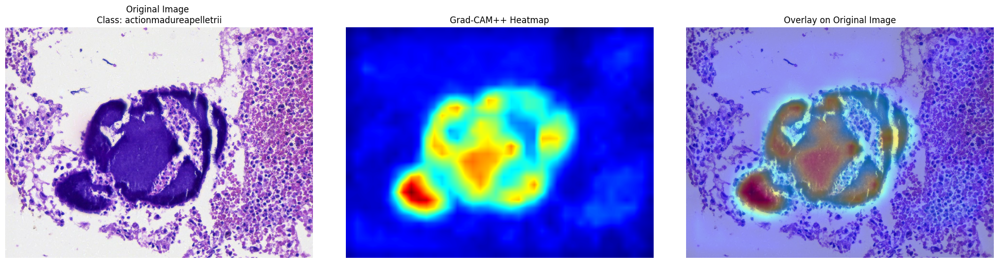

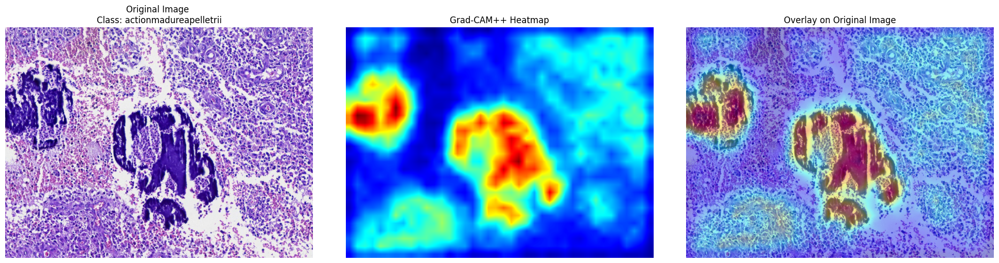

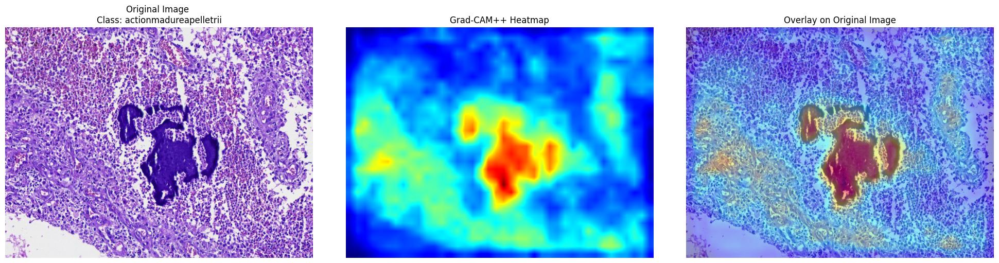

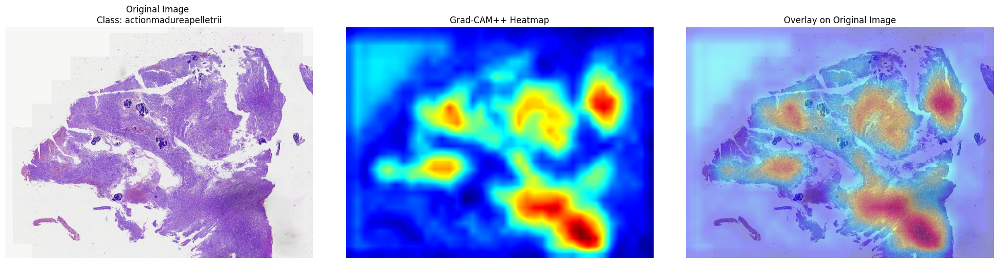

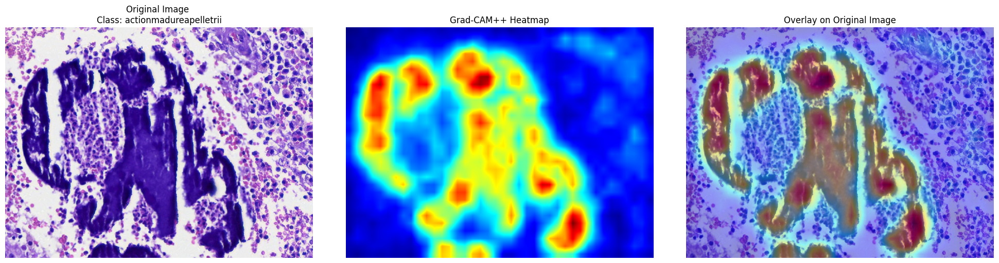

In [ ]:
#Grad-CAM++
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np
from tqdm import tqdm
from monai.visualize import GradCAMpp
from monai.transforms import EnsureType
from PIL import Image, ImageOps

# Load the best model weights
model.load_state_dict(torch.load("/content/drive/MyDrive/Macenko-best_metric_model.pth", map_location=device))
model.eval()

# Define Grad-CAM
cam = GradCAMpp(nn_module=model, target_layers="class_layers.relu")

# Process only the first 5 images
num_images_to_process = 5

for idx, (image, label) in enumerate(test_loader.dataset):
    # Stop after processing 5 images
    if idx >= num_images_to_process:
        break

    # Get the image path and its corresponding file name
    image_path = test_x[idx]
    image_name = os.path.basename(image_path)
    class_name = os.path.basename(os.path.dirname(image_path))  # Extract class name from path

    # Ensure the image is in the right format for model
    image_tensor = EnsureType()(image).unsqueeze(0).to(device)
    label = int(label)  # Ensure label is an integer

    # Generate Grad-CAM heatmap
    heatmap = cam(x=image_tensor, class_idx=label)
    heatmap = heatmap[0].cpu().numpy()

    # Load the original image with original colors using PIL
    original_image = Image.open(image_path).convert('RGB')
    original_image_np = np.array(original_image)

    # Prepare the processed image (as used by the model) for comparison
    processed_img_np = image_tensor[0].cpu().detach().numpy()
    processed_img_np = np.transpose(processed_img_np, (1, 2, 0))  # CHW to HWC
    processed_img_np = (processed_img_np - processed_img_np.min()) / (processed_img_np.max() - processed_img_np.min())  # Normalize to [0, 1]
    processed_img_np = (processed_img_np * 255).astype(np.uint8)  # Convert to uint8 for visualization

    original_height, original_width = original_image_np.shape[:2]

    # Resize heatmap to match the original image dimensions
    heatmap_resized = cv2.resize(heatmap[0], (original_width, original_height))

    # Create overlay for visualization using the original image
    heatmap_colored = cv2.applyColorMap((heatmap_resized * 255).astype(np.uint8), cv2.COLORMAP_JET)

    # Ensure heatmap_colored has the same dimensions as original_image_np
    if original_image_np.shape != heatmap_colored.shape:
        heatmap_colored = cv2.resize(heatmap_colored, (original_image_np.shape[1], original_image_np.shape[0]))

    overlay = cv2.addWeighted(original_image_np, 0.6, heatmap_colored, 0.4, 0)


    # Visualization: Original, Processed, Grad-CAM, and Overlay
    plt.figure(figsize=(20, 5))

    # Original image with true colors
    plt.subplot(1, 3, 1)
    plt.imshow(original_image_np)
    plt.title(f"Original Image \nClass: {class_name}")
    plt.axis("off")

    # Grad-CAM heatmap
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap_colored)
    plt.title("Grad-CAM++ Heatmap")
    plt.axis("off")

    # Overlay on original image
    plt.subplot(1, 3, 3)
    plt.imshow(overlay)
    plt.title("Overlay on Original Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()



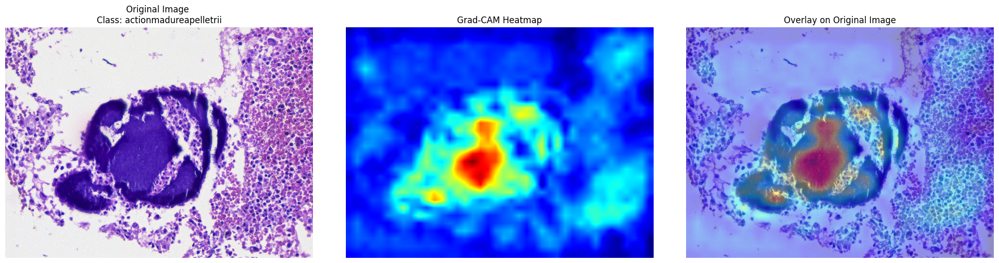

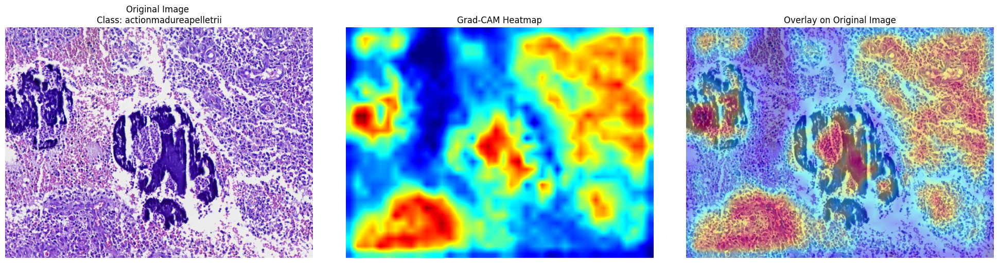

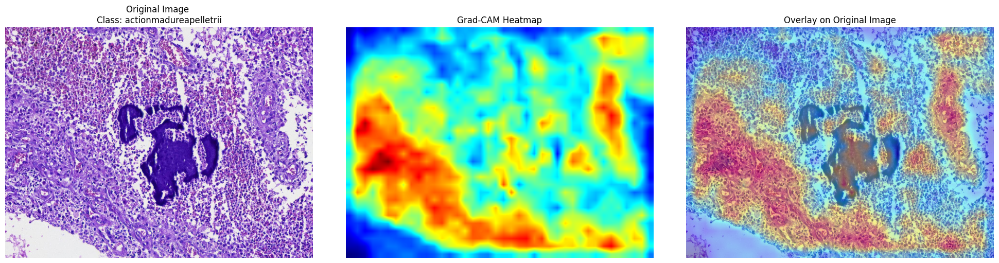

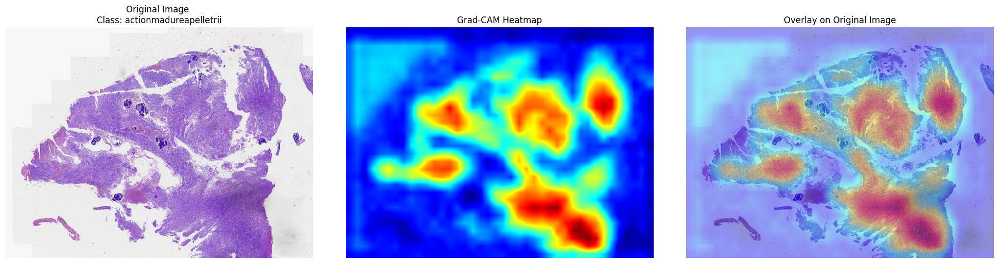

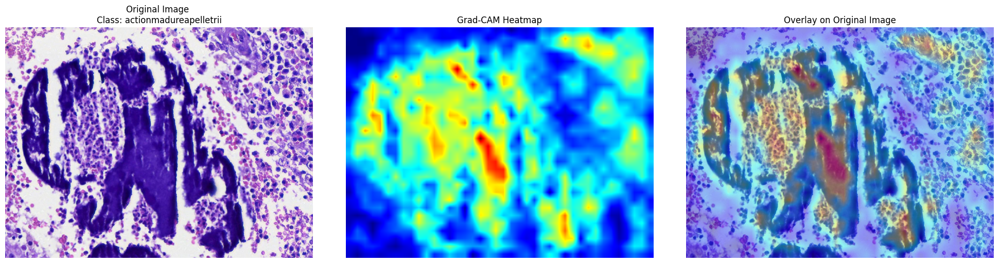

In [ ]:
#Grad-CAM
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np
from tqdm import tqdm
from monai.visualize import GradCAM
from monai.transforms import EnsureType
from PIL import Image, ImageOps

# Load the best model weights
model.load_state_dict(torch.load("/content/drive/MyDrive/Macenko-best_metric_model.pth", map_location=device))
model.eval()

# Define Grad-CAM
cam = GradCAM(nn_module=model, target_layers="class_layers.relu")

# Process only the first 5 images
num_images_to_process = 5

for idx, (image, label) in enumerate(test_loader.dataset):
    # Stop after processing 5 images
    if idx >= num_images_to_process:
        break

    # Get the image path and its corresponding file name
    image_path = test_x[idx]
    image_name = os.path.basename(image_path)
    class_name = os.path.basename(os.path.dirname(image_path))  # Extract class name from path

    # Ensure the image is in the right format for model
    image_tensor = EnsureType()(image).unsqueeze(0).to(device)
    label = int(label)  # Ensure label is an integer

    # Generate Grad-CAM heatmap
    heatmap = cam(x=image_tensor, class_idx=label)
    heatmap = heatmap[0].cpu().numpy()

    # Load the original image with original colors using PIL
    original_image = Image.open(image_path).convert('RGB')
    original_image_np = np.array(original_image)

    # Prepare the processed image (as used by the model) for comparison
    processed_img_np = image_tensor[0].cpu().detach().numpy()
    processed_img_np = np.transpose(processed_img_np, (1, 2, 0))  # CHW to HWC
    processed_img_np = (processed_img_np - processed_img_np.min()) / (processed_img_np.max() - processed_img_np.min())  # Normalize to [0, 1]
    processed_img_np = (processed_img_np * 255).astype(np.uint8)  # Convert to uint8 for visualization

    original_height, original_width = original_image_np.shape[:2]

    # Resize heatmap to match the original image dimensions
    heatmap_resized = cv2.resize(heatmap[0], (original_width, original_height))

    # Create overlay for visualization using the original image
    heatmap_colored = cv2.applyColorMap((heatmap_resized * 255).astype(np.uint8), cv2.COLORMAP_JET)

    # Ensure heatmap_colored has the same dimensions as original_image_np
    if original_image_np.shape != heatmap_colored.shape:
        heatmap_colored = cv2.resize(heatmap_colored, (original_image_np.shape[1], original_image_np.shape[0]))

    overlay = cv2.addWeighted(original_image_np, 0.6, heatmap_colored, 0.4, 0)


    # Visualization: Original, Processed, Grad-CAM, and Overlay
    plt.figure(figsize=(20, 5))

    # Original image with true colors
    plt.subplot(1, 3, 1)
    plt.imshow(original_image_np)
    plt.title(f"Original Image \nClass: {class_name}")
    plt.axis("off")

    # Grad-CAM heatmap
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap_colored)
    plt.title("Grad-CAM Heatmap")
    plt.axis("off")

    # Overlay on original image
    plt.subplot(1, 3, 3)
    plt.imshow(overlay)
    plt.title("Overlay on Original Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()



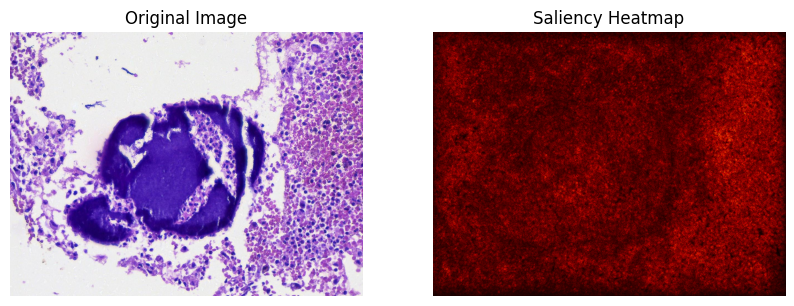

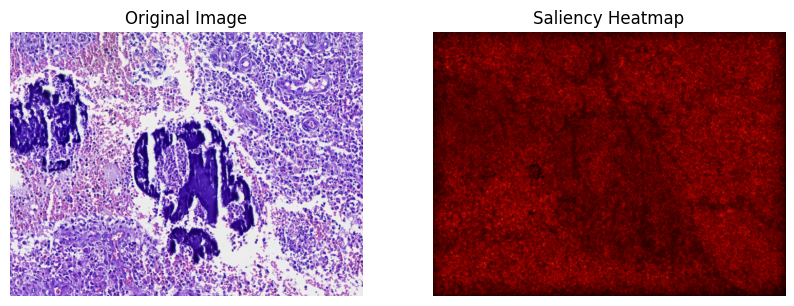

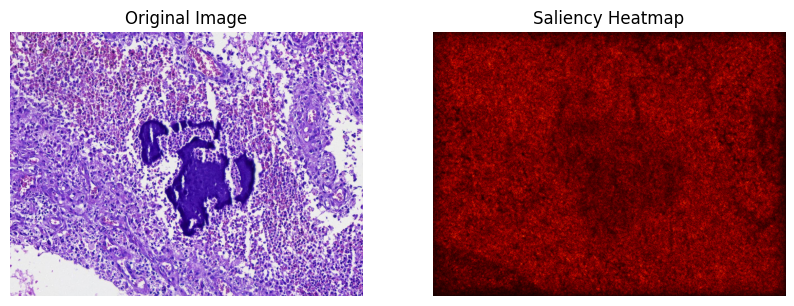

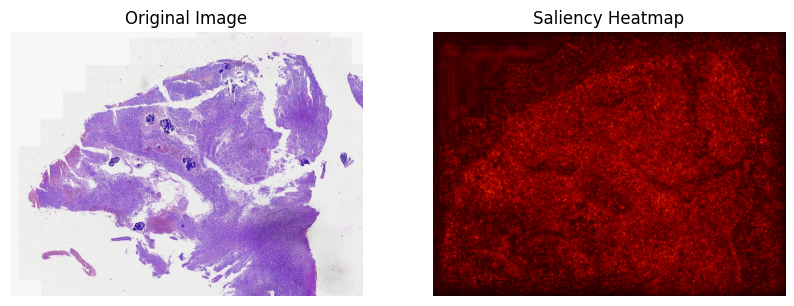

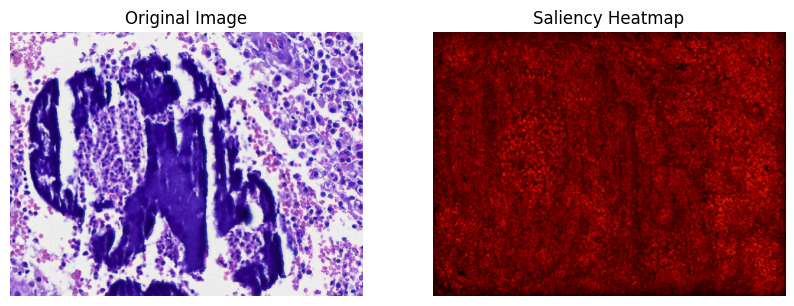

In [ ]:
import torch
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage

# Function to generate saliency map
def generate_saliency_map(model, image, device):
    image = image.to(device).unsqueeze(0)  # Add batch dimension
    image.requires_grad = True  # Enable gradient computation
    model.eval()

    # Forward pass
    outputs = model(image)
    score, _ = torch.max(outputs, 1)  # Focus on the highest scoring class

    # Backward pass
    model.zero_grad()
    score.backward()

    # Extract gradients and compute saliency
    saliency = image.grad.data.abs().squeeze().cpu().numpy()
    saliency = np.max(saliency, axis=0)  # Max over the channels

    return saliency

# Loop through test_loader and visualize saliency maps
for i, (image, label) in enumerate(test_loader):
    image = image.to(device)
    label = label.to(device)

    # Generate saliency map
    saliency_map = generate_saliency_map(model, image[0], device)

    # Plot the original image and saliency map
    plt.figure(figsize=(10, 5))

    # Original image
    plt.subplot(1, 2, 1)
    plt.imshow(image[0].permute(1, 2, 0).cpu().numpy(), cmap='gray')
    plt.title("Original Image")
    plt.axis("off")

    # Saliency map
    plt.subplot(1, 2, 2)
    plt.imshow(saliency_map, cmap='hot')
    plt.title("Saliency Heatmap")
    plt.axis("off")

    plt.show()

    # Stop after a few images for demonstration
    if i == 4:  # Show saliency maps for the first 5 images
        break
